In [1]:
import pandas as pd
from tabulate import tabulate

df_check = pd.read_csv('prices_round_2_day_0.csv', delimiter=';')

print(tabulate(df_check, headers='keys'))

         day    timestamp  product             bid_price_1    bid_volume_1    bid_price_2    bid_volume_2    bid_price_3    bid_volume_3    ask_price_1    ask_volume_1    ask_price_2    ask_volume_2    ask_price_3    ask_volume_3    mid_price    profit_and_loss
-----  -----  -----------  ----------------  -------------  --------------  -------------  --------------  -------------  --------------  -------------  --------------  -------------  --------------  -------------  --------------  -----------  -----------------
    0      0            0  RAINFOREST_RESIN           9998               1           9995              30            nan             nan          10005              30            nan             nan            nan             nan      10001.5                  0
    1      0            0  DJEMBES                   13493              72            nan             nan            nan             nan          13494              72            nan             nan            nan 

In [5]:
import matplotlib.pyplot as plt

df_cro = df_check[df_check['product'] == 'CROISSANTS']
df_jam = df_check[df_check['product'] == 'JAMS']
df_djem = df_check[df_check['product'] == 'DJEMBES']
df_pb1 = df_check[df_check['product'] == 'PICNIC_BASKET1']
df_pb2 = df_check[df_check['product'] == 'PICNIC_BASKET2']
df_kelp = df_check[df_check['product'] == 'KELP']
df_ink = df_check[df_check['product'] == 'SQUID_INK']

In [6]:
import numpy as np
import math

# Compute all the weighted mid prices

bid_price_1 = {'cro': list(df_cro['bid_price_1']), 'jam': list(df_jam['bid_price_1']), 'djem': list(df_djem['bid_price_1']), 'pb1': list(df_pb1['bid_price_1']), 'pb2': list(df_pb2['bid_price_1'])}
bid_volume_1 = {'cro': list(df_cro['bid_volume_1']), 'jam': list(df_jam['bid_volume_1']), 'djem': list(df_djem['bid_volume_1']), 'pb1': list(df_pb1['bid_volume_1']), 'pb2': list(df_pb2['bid_volume_1'])}

bid_price_2 = {'cro': list(df_cro['bid_price_2']), 'jam': list(df_jam['bid_price_2']), 'djem': list(df_djem['bid_price_2']), 'pb1': list(df_pb1['bid_price_2']), 'pb2': list(df_pb2['bid_price_2'])}
bid_volume_2 = {'cro': list(df_cro['bid_volume_2']), 'jam': list(df_jam['bid_volume_2']), 'djem': list(df_djem['bid_volume_2']), 'pb1': list(df_pb1['bid_volume_2']), 'pb2': list(df_pb2['bid_volume_2'])}

bid_price_3 = {'cro': list(df_cro['bid_price_3']), 'jam': list(df_jam['bid_price_3']), 'djem': list(df_djem['bid_price_3']), 'pb1': list(df_pb1['bid_price_3']), 'pb2': list(df_pb2['bid_price_3'])}
bid_volume_3 = {'cro': list(df_cro['bid_volume_3']), 'jam': list(df_jam['bid_volume_3']), 'djem': list(df_djem['bid_volume_3']), 'pb1': list(df_pb1['bid_volume_3']), 'pb2': list(df_pb2['bid_volume_3'])}

ask_price_1 = {'cro': list(df_cro['ask_price_1']), 'jam': list(df_jam['ask_price_1']), 'djem': list(df_djem['ask_price_1']), 'pb1': list(df_pb1['ask_price_1']), 'pb2': list(df_pb2['ask_price_1'])}
ask_volume_1 = {'cro': list(df_cro['ask_volume_1']), 'jam': list(df_jam['ask_volume_1']), 'djem': list(df_djem['ask_volume_1']), 'pb1': list(df_pb1['ask_volume_1']), 'pb2': list(df_pb2['ask_volume_1'])}

ask_price_2 = {'cro': list(df_cro['ask_price_2']), 'jam': list(df_jam['ask_price_2']), 'djem': list(df_djem['ask_price_2']), 'pb1': list(df_pb1['ask_price_2']), 'pb2': list(df_pb2['ask_price_2'])}
ask_volume_2 = {'cro': list(df_cro['ask_volume_2']), 'jam': list(df_jam['ask_volume_2']), 'djem': list(df_djem['ask_volume_2']), 'pb1': list(df_pb1['ask_volume_2']), 'pb2': list(df_pb2['ask_volume_2'])}

ask_price_3 = {'cro': list(df_cro['ask_price_3']), 'jam': list(df_jam['ask_price_3']), 'djem': list(df_djem['ask_price_3']), 'pb1': list(df_pb1['ask_price_3']), 'pb2': list(df_pb2['ask_price_3'])}
ask_volume_3 = {'cro': list(df_cro['ask_volume_3']), 'jam': list(df_jam['ask_volume_3']), 'djem': list(df_djem['ask_volume_3']), 'pb1': list(df_pb1['ask_volume_3']), 'pb2': list(df_pb2['ask_volume_3'])}

mid_weight = {'cro': [], 'jam': [], 'djem': [], 'pb1': [], 'pb2': []}

products = ['cro', 'jam', 'djem', 'pb1', 'pb2']
for prod in products:
    for i in range(len(bid_price_1[prod])):
        total_weight = 0
        mid_weight_curr = 0
        if not math.isnan(bid_price_1[prod][i]):
            mid_weight_curr += bid_price_1[prod][i] * bid_volume_1[prod][i]
            total_weight += bid_volume_1[prod][i]
    
        if not math.isnan(bid_price_2[prod][i]):
            mid_weight_curr += bid_price_2[prod][i] * bid_volume_2[prod][i]
            total_weight += bid_volume_2[prod][i]
    
        if not math.isnan(bid_price_3[prod][i]):
            mid_weight_curr += bid_price_3[prod][i] * bid_volume_3[prod][i]
            total_weight += bid_volume_3[prod][i]

        if not math.isnan(ask_price_1[prod][i]):
            mid_weight_curr += ask_price_1[prod][i] * ask_volume_1[prod][i]
            total_weight += ask_volume_1[prod][i]
    
        if not math.isnan(ask_price_2[prod][i]):
            mid_weight_curr += ask_price_2[prod][i] * ask_volume_2[prod][i]
            total_weight += ask_volume_2[prod][i]
    
        if not math.isnan(ask_price_3[prod][i]):
            mid_weight_curr += ask_price_3[prod][i] * ask_volume_3[prod][i]
            total_weight += ask_volume_3[prod][i]

        mid_weight[prod].append(mid_weight_curr / total_weight if total_weight != 0 else 0)
    


C:\Users\amino\AppData\Local\Temp\ipykernel_19640\3828422133.py:10: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


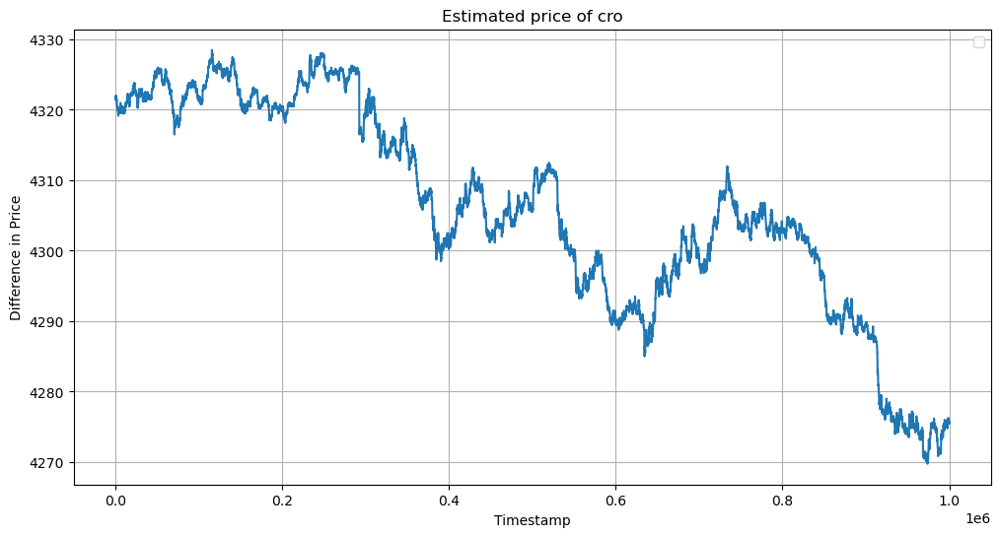

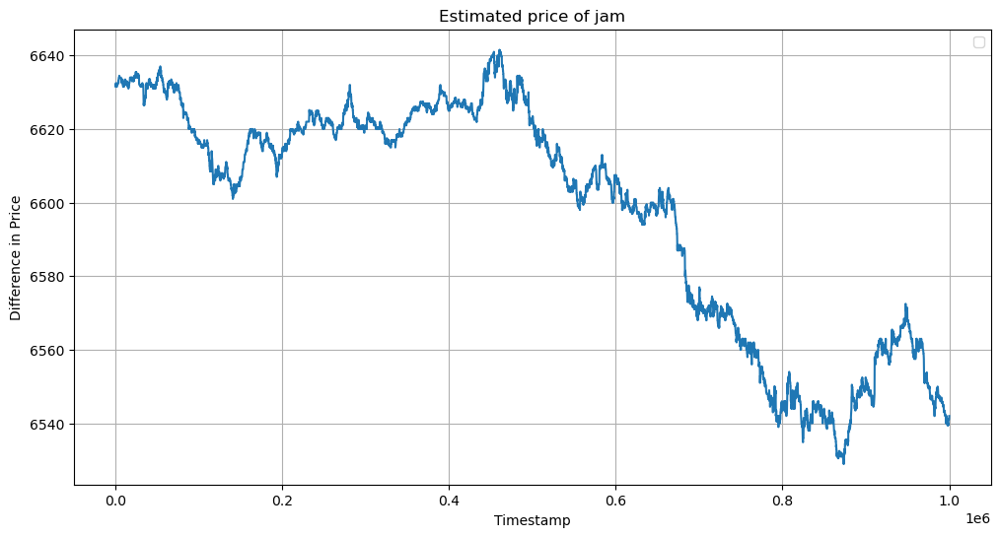

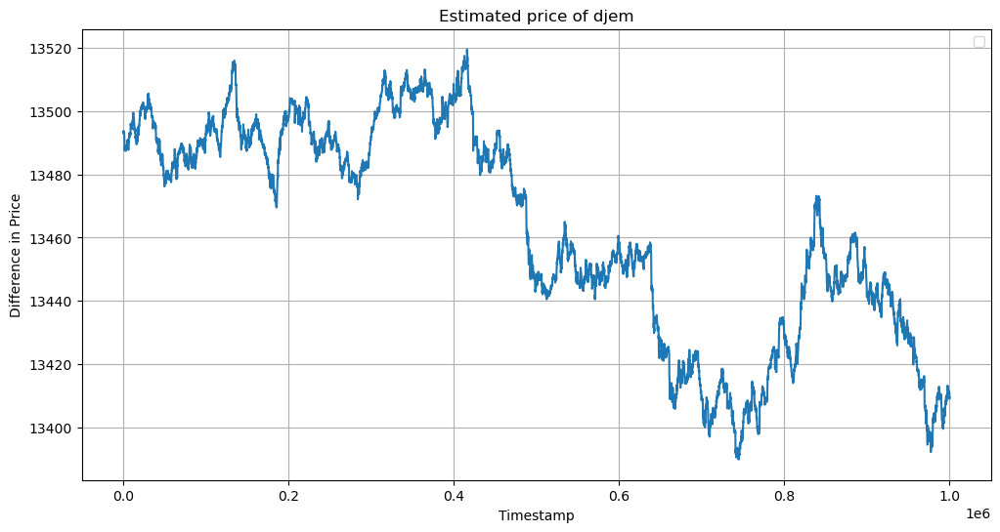

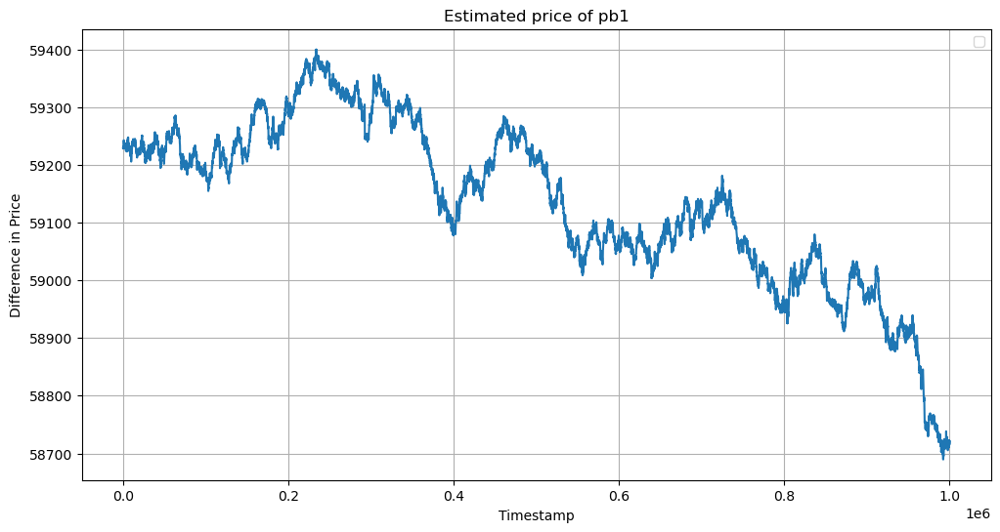

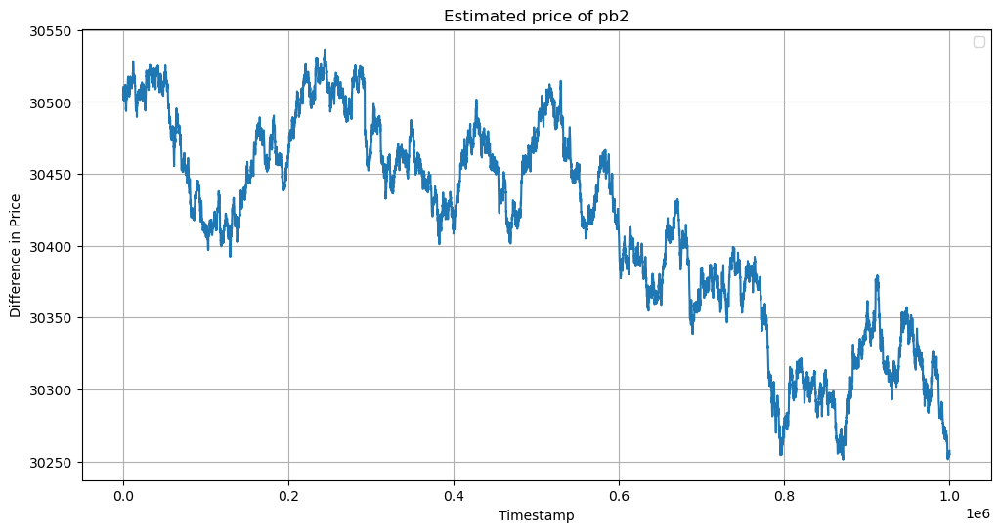

In [7]:
time = list(df_cro['timestamp'])


for prod in products:
    plt.figure(figsize=(12, 6))
    plt.plot(time, mid_weight[prod])
    plt.xlabel('Timestamp')
    plt.ylabel('Difference in Price')
    plt.title('Estimated price of ' + prod)
    plt.legend()
    plt.grid(True)
    #plt.xlim([800000,1000000])
    plt.show()

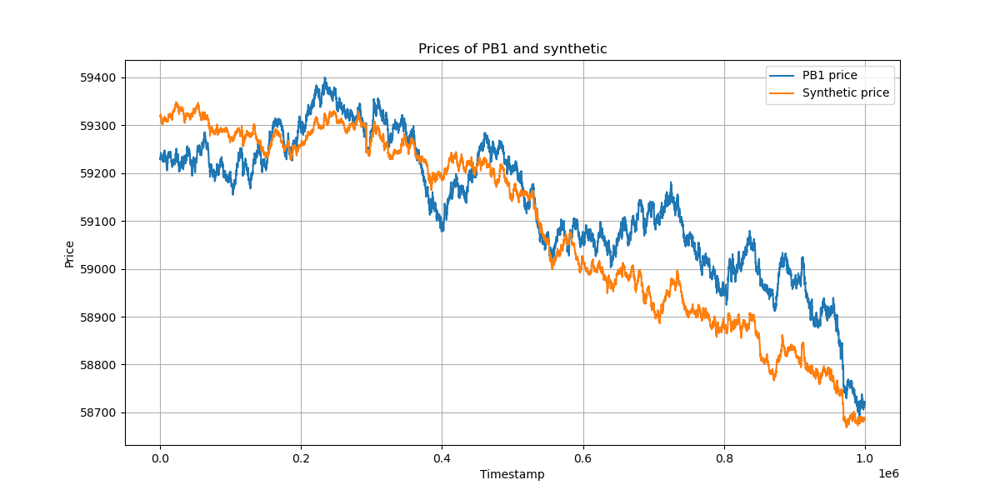

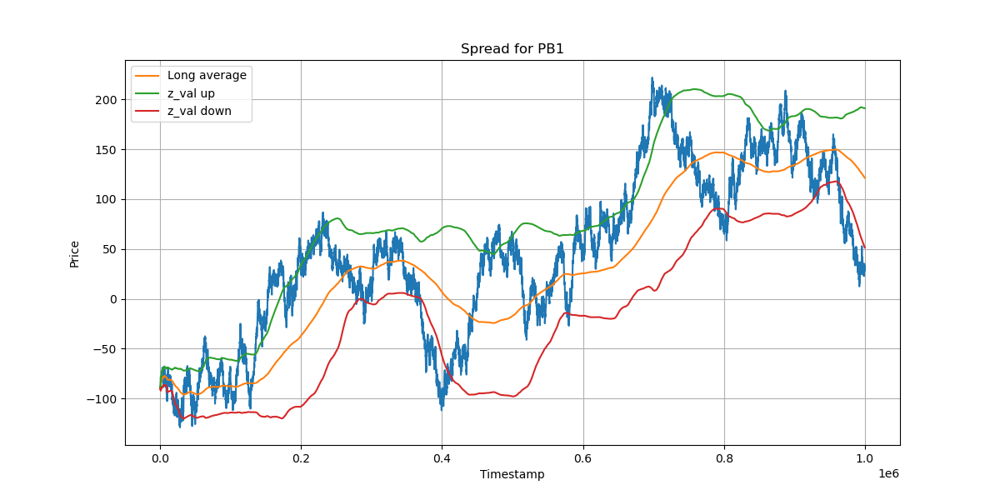

C:\Users\amino\AppData\Local\Temp\ipykernel_19640\525845693.py:81: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


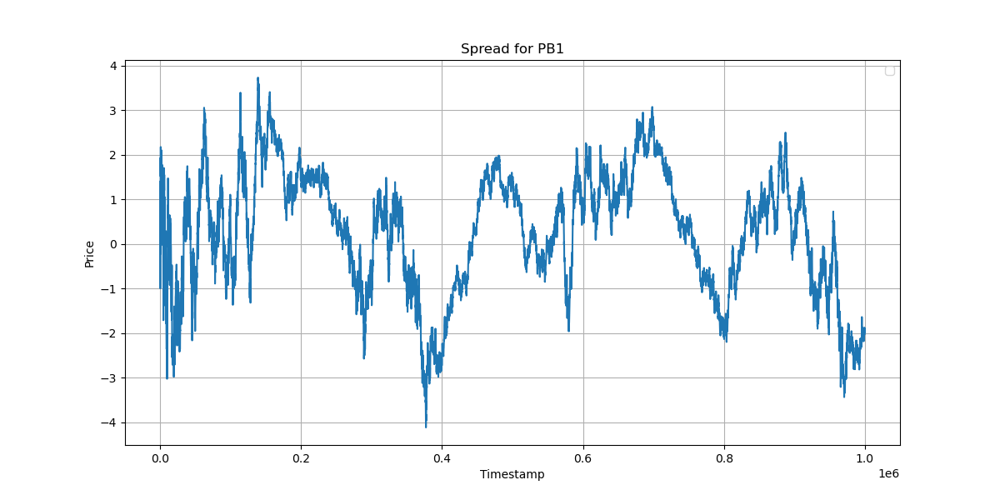

In [9]:
%matplotlib ipympl
len_long = 1300
z_max = 1.5

time_lst = list(df_cro['timestamp'])
cro_price = mid_weight['cro']
jam_price = mid_weight['jam']
djem_price = mid_weight['djem']
pb1_price = mid_weight['pb1']
pb2_price = mid_weight['pb2']

basket1_synt = [6 * cro_price[i] + 3 * jam_price[i] + djem_price[i] for i in range(len(time_lst))]
#basket_average = [(basket_synt[i] + pb1_price[i])/2 for i in range(len(time_lst))]
basket1_diff = [pb1_price[i] - basket1_synt[i] for i in range(len(time_lst))]

spread1_win = []
spread1_mean = []
spread1_up = []
spread1_down = []
z_score = []
stdev_lst = []


for x in basket1_diff:
    if len(spread1_win) < len_long:
        spread1_win.append(x)
    else:
        spread1_win.pop(0)
        spread1_win.append(x)

    mean_win = sum(spread1_win)/len(spread1_win)
    spread1_mean.append(mean_win)

    stdev_sq_win = 0
    for p in spread1_win:
        stdev_sq_win += (p - mean_win) ** 2

    stdev_win = math.sqrt(stdev_sq_win/len(spread1_win))
    spread1_up.append(mean_win + z_max * stdev_win)
    spread1_down.append(mean_win - z_max * stdev_win)

    stdev_lst.append(stdev_sq_win/50)
    
    if stdev_win:
        z_score.append((x - mean_win)/stdev_win)
    else:
        z_score.append(0)

plt.figure(figsize=(12, 6))
plt.plot(time_lst, pb1_price, label = 'PB1 price')
plt.plot(time_lst, basket1_synt, label = 'Synthetic price')
#plt.plot(time_lst, basket_average)
plt.xlabel('Timestamp')
plt.ylabel('Price')
plt.title('Prices of PB1 and synthetic')
plt.legend()
plt.grid(True)
#plt.xlim([0,200000])
#plt.ylim([-50,200])
plt.show()

plt.figure(figsize=(12, 6))
plt.plot(time_lst, basket1_diff)
plt.plot(time_lst, spread1_mean, label = 'Long average')
plt.plot(time_lst, spread1_up, label = 'z_val up')
plt.plot(time_lst, spread1_down, label = 'z_val down')
plt.xlabel('Timestamp')
plt.ylabel('Price')
plt.title('Spread for PB1')
plt.legend()
plt.grid(True)
#plt.xlim([0,200000])
#plt.ylim([-50,200])
plt.show()

plt.figure(figsize=(12, 6))
plt.plot(time_lst, z_score)
plt.xlabel('Timestamp')
plt.ylabel('Price')
plt.title('Spread for PB1')
plt.legend()
plt.grid(True)
#plt.xlim([0,200000])
#plt.ylim([-50,200])
plt.show()

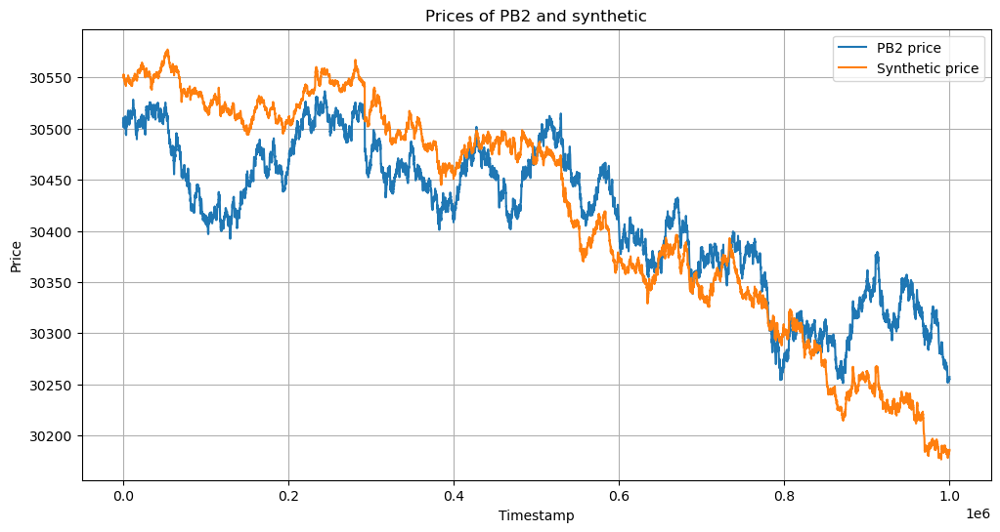

C:\Users\amino\AppData\Local\Temp\ipykernel_22584\1027703811.py:24: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


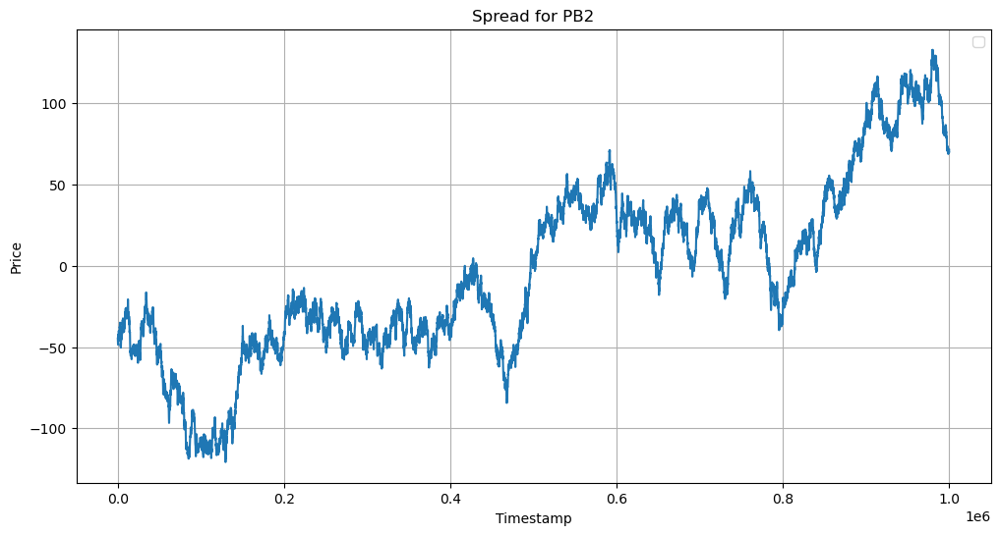

In [11]:
basket2_synt = [4 * cro_price[i] + 2 * jam_price[i] for i in range(len(time_lst))]
#basket_average = [(basket_synt[i] + pb1_price[i])/2 for i in range(len(time_lst))]
basket2_diff = [pb2_price[i] - basket2_synt[i] for i in range(len(time_lst))]

plt.figure(figsize=(12, 6))
plt.plot(time_lst, pb2_price, label = 'PB2 price')
plt.plot(time_lst, basket2_synt, label = 'Synthetic price')
#plt.plot(time_lst, basket_average)
plt.xlabel('Timestamp')
plt.ylabel('Price')
plt.title('Prices of PB2 and synthetic')
plt.legend()
plt.grid(True)
#plt.xlim([0,200000])
#plt.ylim([-50,200])
plt.show()

plt.figure(figsize=(12, 6))
plt.plot(time_lst, basket2_diff)
#plt.plot(time_lst, basket_average)
plt.xlabel('Timestamp')
plt.ylabel('Price')
plt.title('Spread for PB2')
plt.legend()
plt.grid(True)
#plt.xlim([0,200000])
#plt.ylim([-50,200])
plt.show()

PB1 Intercept: 18961.627313278223
PB1 Coefficients Cro, Jam, Djem: [5.91712422 1.58730958 0.31362812]
PB1 root of MSE:  50.816695563813695


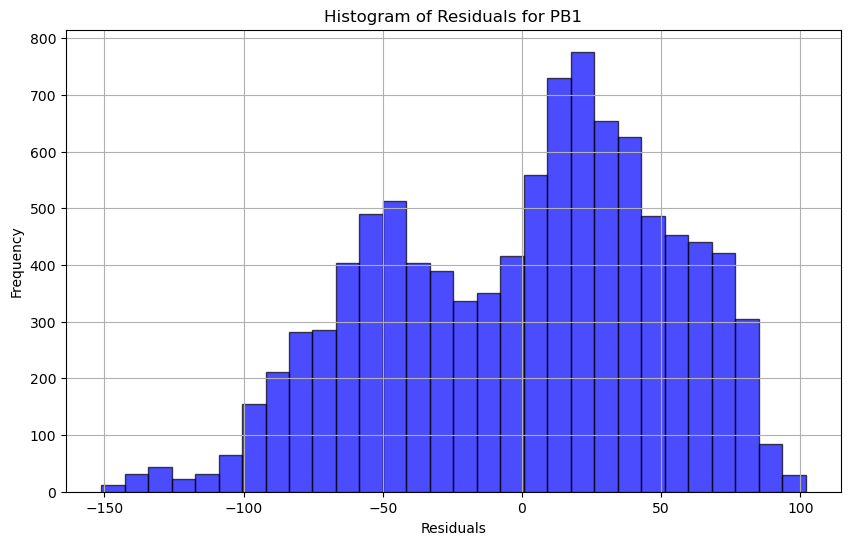

In [6]:
import numpy as np
import math
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

time_lst = list(df_cro['timestamp'])
cro_price = mid_weight['cro']
jam_price = mid_weight['jam']
djem_price = mid_weight['djem']
pb1_price = mid_weight['pb1']
pb2_price = mid_weight['pb2']

# Linear Regression model
model = LinearRegression()

Vars = []
y = []
time = []

for i in range(len(cro_price)):
    Vars.append([cro_price[i],jam_price[i],djem_price[i]])
    y.append(pb1_price[i])
    time.append(time_lst[i])

X = np.array(Vars)

# Fitting the model
model.fit(X, y)

# Prediction
y_pred = model.predict(X)
#print("Predictions:", y_pred)

# Coefficients and intercept
print("PB1 Intercept:", model.intercept_)
print("PB1 Coefficients Cro, Jam, Djem:", model.coef_)

print("PB1 root of MSE: ", math.sqrt(mean_squared_error(y, y_pred)))

# Calculate residuals
residuals = [y[i] - y_pred[i] for i in range(len(y))]

# Create a histogram for residuals
plt.figure(figsize=(10, 6))
plt.hist(residuals, bins=30, color='blue', edgecolor='black', alpha=0.7)
plt.xlabel('Residuals')
plt.ylabel('Frequency')
plt.title('Histogram of Residuals for PB1')
plt.grid(True)
plt.show()


PB2 Intercept: 16449.361646742702
PB2 Coefficients Cro, Jam, Djem: [ 1.49901232  1.88434182 -0.36555942]
PB2 root of MSE:  24.984597503940975


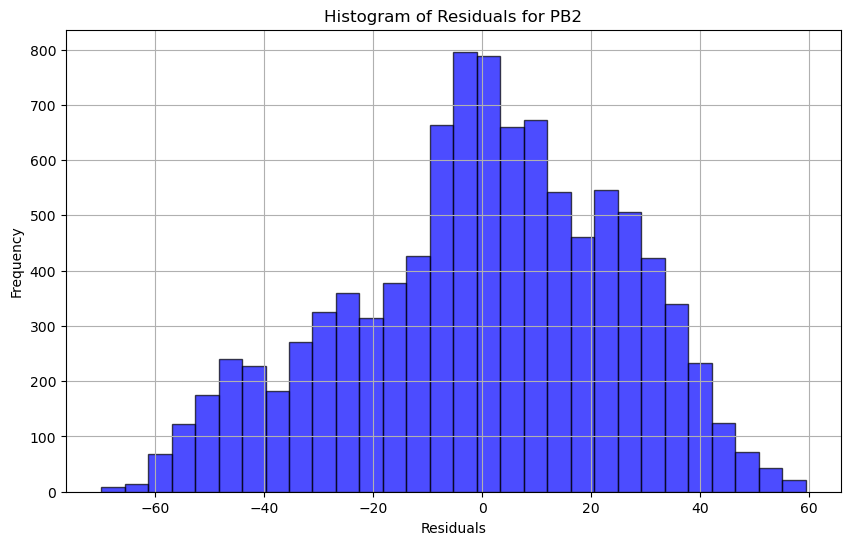

In [7]:
Vars = []
y = []
time = []

for i in range(len(cro_price)):
    Vars.append([cro_price[i],jam_price[i],djem_price[i]])
    y.append(pb2_price[i])
    time.append(time_lst[i])

X = np.array(Vars)

# Fitting the model
model.fit(X, y)

# Prediction
y_pred = model.predict(X)
#print("Predictions:", y_pred)

# Coefficients and intercept
print("PB2 Intercept:", model.intercept_)
print("PB2 Coefficients Cro, Jam, Djem:", model.coef_)

print("PB2 root of MSE: ",math.sqrt(mean_squared_error(y, y_pred)))

# Calculate residuals
residuals = [y[i] - y_pred[i] for i in range(len(y))]

# Create a histogram for residuals
plt.figure(figsize=(10, 6))
plt.hist(residuals, bins=30, color='blue', edgecolor='black', alpha=0.7)
plt.xlabel('Residuals')
plt.ylabel('Frequency')
plt.title('Histogram of Residuals for PB2')
plt.grid(True)
plt.show()


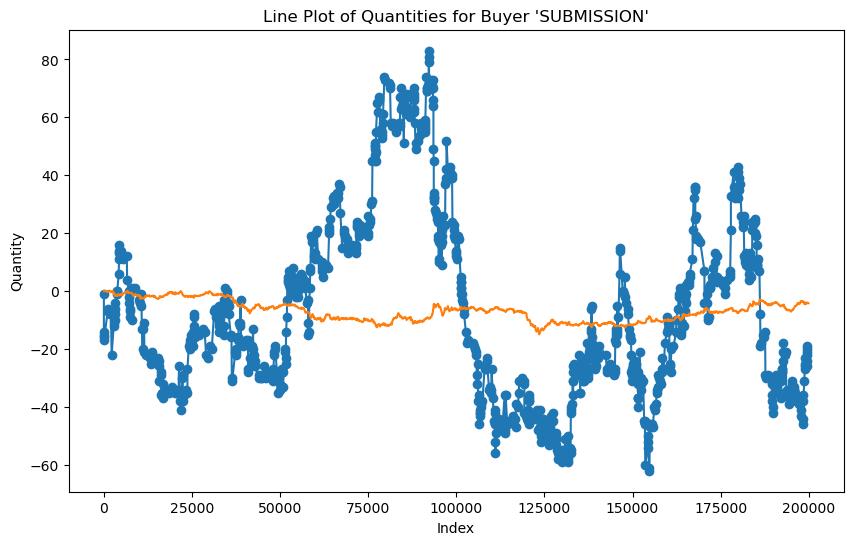

In [54]:
import json
import matplotlib.pyplot as plt

filename = "Log_kelp_ga.log"
json_str = ""
found = False

with open(filename, "r") as f:
    # Read lines until we find the marker "Trade History:"
    for line in f:
        if "Trade History:" in line:
            # If the same line contains the opening bracket, use it
            if "[" in line:
                json_str = line[line.find("["):]
            else:
                # Otherwise, assume the next line starts the JSON array
                json_str = next(f)
            found = True
            break

    if not found:
        raise ValueError("Could not find 'Trade History:' with '[' in file.")

    # Append the remainder of the file to the JSON string
    json_str += f.read()

# Parse the JSON string into a list of trade objects
data = json.loads(json_str)

# Calculate the total quantity and total money paid for buyer "SUBMISSION"
quantities = []
time_lst = []
quantity = 0
for item in data:
    if item.get("buyer") == "SUBMISSION":
        quantity += item.get("quantity", 0)
        quantities.append(quantity)
        timestamp = item.get("timestamp", 0)
        time_lst.append(timestamp)
    elif item.get("seller") == "SUBMISSION":
        quantity -= item.get("quantity", 0)
        quantities.append(quantity)
        timestamp = item.get("timestamp", 0)
        time_lst.append(timestamp)

# Plot the quantities as a line plot
plt.figure(figsize=(10, 6))
plt.plot(time_lst, quantities, marker='o', linestyle='-')
plt.plot(df_kelp['timestamp'], df_kelp['profit_and_loss'])
plt.xlabel("Index")
plt.ylabel("Quantity")
plt.title("Line Plot of Quantities for Buyer 'SUBMISSION'")
plt.show()

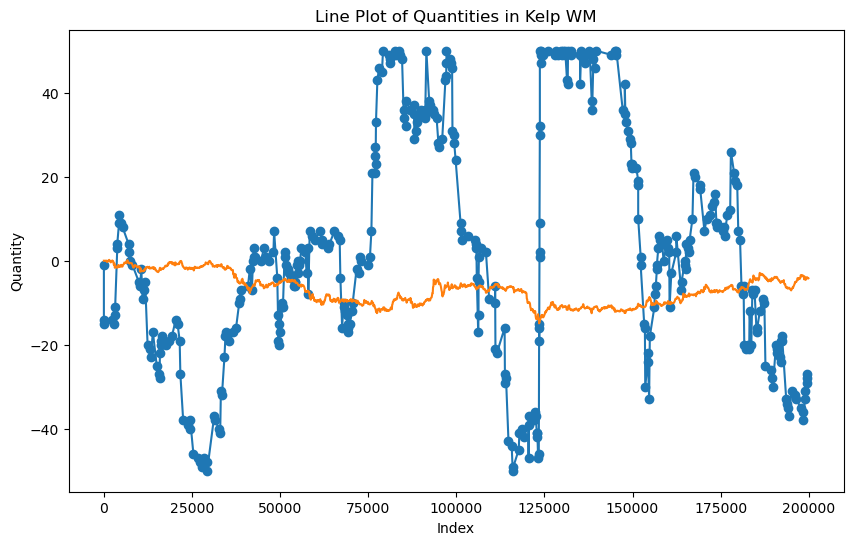

In [52]:
import json
import matplotlib.pyplot as plt

filename = "Log_kelp_wm_ga.log"
json_str = ""
found = False

with open(filename, "r") as f:
    # Read lines until we find the marker "Trade History:"
    for line in f:
        if "Trade History:" in line:
            # If the same line contains the opening bracket, use it
            if "[" in line:
                json_str = line[line.find("["):]
            else:
                # Otherwise, assume the next line starts the JSON array
                json_str = next(f)
            found = True
            break

    if not found:
        raise ValueError("Could not find 'Trade History:' with '[' in file.")

    # Append the remainder of the file to the JSON string
    json_str += f.read()

# Parse the JSON string into a list of trade objects
data = json.loads(json_str)

# Calculate the total quantity and total money paid for buyer "SUBMISSION"
quantities = []
time_lst = []
quantity = 0
for item in data:
    if item.get("buyer") == "SUBMISSION":
        quantity += item.get("quantity", 0)
        quantities.append(quantity)
        timestamp = item.get("timestamp", 0)
        time_lst.append(timestamp)
    elif item.get("seller") == "SUBMISSION":
        quantity -= item.get("quantity", 0)
        quantities.append(quantity)
        timestamp = item.get("timestamp", 0)
        time_lst.append(timestamp)

# Plot the quantities as a line plot
plt.figure(figsize=(10, 6))
plt.plot(time_lst, quantities, marker='o', linestyle='-')
plt.plot(df_kelp['timestamp'], df_kelp['profit_and_loss'])
plt.xlabel("Index")
plt.ylabel("Quantity")
plt.title("Line Plot of Quantities in Kelp WM")
plt.show()

In [15]:
from datamodel import OrderDepth, UserId, TradingState, Order

product = "KELP"
pos_limit = 50
dump_range = 30
max_profit = 1

orders = []
position = 19
sell_amount = 0

buy_quantity = 0
sell_quantity = 0

if pos_limit - dump_range <= position <= pos_limit:
    sell_amount = position
    orders.append(Order(product,round(2026) + 1,-sell_amount))
    sell_quantity += sell_amount

    print(position - sell_amount)

if -pos_limit <= position <= -pos_limit + dump_range:
    buy_amount = - position
    orders.append(Order(product,round(2026) - 1,buy_amount))
    buy_quantity += buy_amount

    print(position + buy_amount)



In [6]:
int(1.7)
round(1.4)

1